In [24]:
import os
import numpy as np
import tifffile as tiff
import matplotlib.pyplot as plt
import cv2
import math


# Define folder path
base_folder = "./IDP Group A/test2/operator2"

# Define wavelength list (450 nm to 950 nm in 20 nm steps)
wavelengths = list(range(450, 951, 20))

# Define subfolders
# sample_folders = [f"d{i}" for i in range(1, 15)]  # d1 to d14
sample_folders = ['d0', 'd3', 'd4', 'd7', 'd10', 'd12', 'd13', 'd18', 'd19', 'd20', 'd21', 'd22']
dark_folder = "dark"
white_folder = "white"
reference_folder = "reference"


# Load white and dark images
def load_cube(folder_path):
    tif_files = [f for f in os.listdir(folder_path) if f.lower().endswith(".tif")]
    tif_files.sort()

    cube = []
    for tif_file in tif_files:
        tif_path = os.path.join(folder_path, tif_file)
        tif = tiff.imread(tif_path)
        cube.append(tif)

    cube = np.array(cube)

    return cube


# Load dark and white reference cubes
dark_cube = load_cube(os.path.join(base_folder, dark_folder))
white_cube = load_cube(os.path.join(base_folder, white_folder))
reference_cube = load_cube(os.path.join(base_folder, reference_folder))


# Avoid division by zero
denominator = white_cube - dark_cube
denominator[denominator == 0] = 1e-6

# Load and compute reflectance for each sample
defect_cubes = {}

for folder in sample_folders:
    sample_cube = load_cube(os.path.join(base_folder, folder))
    R = (sample_cube - dark_cube) / denominator
    defect_cubes[folder] = R  # Shape: (bands, height, width)

In [25]:
R_sample = (reference_cube - dark_cube) / denominator

print(f"R_sample.shape: {R_sample.shape}")

R_sample.shape: (26, 1040, 1392)


In [26]:

def plot_image(image, title=""):
    # Plot the image
    plt.figure(figsize=(6, 5))
    plt.imshow(image, cmap="gray")
    plt.colorbar(label="Pixel Value")
    plt.title(title)
    plt.axis("off")
    plt.tight_layout()
    plt.show()


def plot_example_reflectance(defect_cubes, sample_name, wavelength):
    # Get reflectance cube
    R = defect_cubes[sample_name]

    # Extract 2D image at selected wavelength
    reflectance_image = R[wavelengths.index(wavelength), :, :]
    title = f"Reflectance of {sample_name} at {wavelength} nm"

    plot_image(reflectance_image, title)


def plot_original_tif(tif_path):
    image = tiff.imread(tif_path)

    plot_image(image, tif_path)


def get_example_reflectance(defect_cubes, sample_name, wavelength):
    # Get reflectance cube
    R = defect_cubes[sample_name]

    # Extract 2D image at selected wavelength
    reflectance_image = R[wavelengths.index(wavelength), :, :]

    return reflectance_image

In [ ]:

from sklearn.cluster import KMeans
from scipy.ndimage import binary_fill_holes
from matplotlib.colors import ListedColormap
import matplotlib.patches as mpatches




def convert_binary_image(defect_cubes, defect, band):
    gray = get_example_reflectance(defect_cubes, defect, band)
    gray_norm = gray / np.max(gray)
    gray_norm = (gray_norm * 255).astype(np.uint8)
    _, binary_image = cv2.threshold(gray_norm, 60, 255, cv2.THRESH_BINARY_INV)

    return binary_image


def overlay_mask(base_image, mask, title, color=(1, 0, 0), alpha=0.5):
    base_image = base_image.astype(np.float32)
    if base_image.shape[0] == 3:
        base_image = np.transpose(base_image, (1, 2, 0))
    base_norm = base_image / 255.0 if base_image.max() > 1 else base_image

    overlay = np.zeros_like(base_norm)
    overlay[..., :3] = color

    blended = base_norm.copy()
    mask_bool = mask == 1
    blended[mask_bool] = (1 - alpha) * base_norm[mask_bool] + alpha * overlay[mask_bool]

    plt.figure(figsize=(6, 6))
    plt.imshow(np.clip(blended, 0, 1))
    plt.axis("off")
    plt.title(title)
    plt.show()


# def compute_IC_mask(RGB_image):
#     RGB_image = RGB_image.astype(np.float32)

#     if RGB_image.shape[0] == 3:
#         RGB_image = np.transpose(RGB_image, (1, 2, 0))

#     height, width, bands = RGB_image.shape
#     pixels = RGB_image.reshape(-1, bands)
#     pixels /= np.linalg.norm(pixels, axis=1, keepdims=True) + 1e-6

#     k_means = KMeans(n_clusters=5, random_state=0, n_init=10)
#     labels = k_means.fit_predict(pixels)
#     segmented_image = labels.reshape(height, width)

#     pixel_IC = (300, 190)
#     IC_label = segmented_image[pixel_IC]
#     mask = (segmented_image == IC_label).astype(np.uint8)

#     flood_mask = mask.copy()
#     cv2.floodFill(flood_mask, None, (pixel_IC[1], pixel_IC[0]), 128)
#     circle_mask = (flood_mask == 128).astype(np.uint8)

#     kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
#     closed = cv2.morphologyEx(circle_mask, cv2.MORPH_CLOSE, kernel)
#     filled = binary_fill_holes(closed > 0)

#     return filled.astype(np.uint8)

def compute_IC_mask(RGB_image, H=None, vis=True, pixel_IC=(220, 380)):
    RGB_image = RGB_image.astype(np.float32)

    if RGB_image.shape[0] == 3:
        RGB_image = np.transpose(RGB_image, (1, 2, 0))

    height, width, bands = RGB_image.shape
    pixels = RGB_image.reshape(-1, bands)
    pixels /= np.linalg.norm(pixels, axis=1, keepdims=True) + 1e-6

    k_means = KMeans(n_clusters=5, random_state=0, n_init=10)
    labels = k_means.fit_predict(pixels)
    segmented_image = labels.reshape(height, width)

    if H is not None:
        h, w, b = RGB_image.shape
        segmented_image = segmented_image.astype(np.float32)
        segmented_image = cv2.warpAffine(segmented_image, H, (w, h))

    # Plooot clustering kmeans
    if vis:
        num_clusters = 5
        cmap_base = plt.get_cmap("tab10")

        # Build a ListedColormap with exactly num_clusters distinct colors
        colors = [cmap_base(i) for i in range(num_clusters)]
        cmap = ListedColormap(colors)

        plt.figure(figsize=(8, 6))

        # Display the segmented image with the defined colormap
        im = plt.imshow(segmented_image, cmap=cmap)
        plt.title("K-Means Segmentation (5 Clusters)")
        plt.axis("off")

        # Create legend patches that use *exactly* the same colors
        patches = [
            mpatches.Patch(color=colors[i], label=f"Cluster {i+1}")
            for i in range(num_clusters)
        ]

        plt.legend(
            handles=patches,
            loc="upper right",
            bbox_to_anchor=(1.25, 1),
            title="Clusters",
        )
        plt.show()
    ###############

    # Get cluster that contains IC
    IC_label = segmented_image[(pixel_IC[1], pixel_IC[0])]
    mask = (segmented_image == IC_label).astype(np.uint8)

    # Using cluster region growing from center of IC
    flood_mask = mask.copy()
    cv2.floodFill(flood_mask, None, (pixel_IC[0], pixel_IC[1]), 128)
    circle_mask = (flood_mask == 128).astype(np.uint8)

    # Improve circle, fill holes
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (15, 15))
    closed = cv2.morphologyEx(circle_mask, cv2.MORPH_CLOSE, kernel)
    filled = binary_fill_holes(closed > 0)

    if vis:
        plt.imshow(filled.astype(np.uint8))
        plt.show()

    return filled.astype(np.uint8)

def align_and_visualise_homography(img_ref, img_to_align, defect, n_features=7000): #increase feature size in case of bad matches
    
    img_to_align = cv2.equalizeHist(img_to_align)

    orb = cv2.ORB_create(n_features)
    kp1, des1 = orb.detectAndCompute(img_ref, None)
    kp2, des2 = orb.detectAndCompute(img_to_align, None)

    bf = cv2.BFMatcher(cv2.NORM_HAMMING)
    matches_raw = bf.knnMatch(des1, des2, k=2)
    matches = [m for m, n in matches_raw if m.distance < 0.75 * n.distance]


    if len(matches) < 10:
        print(f"Not enough matches for {defect}")
        return None

    pts_ref = np.float32([kp1[m.queryIdx].pt for m in matches]).reshape(-1, 2)
    pts_to = np.float32([kp2[m.trainIdx].pt for m in matches]).reshape(-1, 2)

    # Compute homography using RANSAC
    H, mask = cv2.findHomography(pts_to, pts_ref, cv2.RANSAC, 5.0) #increase RANSAC threshold in case of noisy image

    if H is None:
        print(f"Homography estimation failed for {defect}")
        return None

    aligned = cv2.warpPerspective(img_to_align, H, (img_ref.shape[1], img_ref.shape[0]))

    # Visualization
    match_vis = cv2.drawMatches(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        kp1,
        cv2.cvtColor(img_to_align, cv2.COLOR_GRAY2BGR),
        kp2,
        matches[:50],
        None,
        flags=cv2.DrawMatchesFlags_NOT_DRAW_SINGLE_POINTS,
    )

    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(match_vis)
    plt.title(f"Feature matches: {defect}")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(aligned, cmap="gray")
    plt.title(f"Aligned binary ({defect})")
    plt.axis("off")

    overlay = cv2.addWeighted(
        cv2.cvtColor(img_ref, cv2.COLOR_GRAY2BGR),
        0.5,
        cv2.cvtColor(aligned, cv2.COLOR_GRAY2BGR),
        0.5,
        0,
    )
    plt.subplot(1, 3, 3)
    plt.imshow(overlay)
    plt.title(f"Overlap ({defect})")
    plt.axis("off")

    plt.show()

    return H


def align_and_blend_RGB_homography(ref_rgb, defect_rgb, H, defect_name):
    """
    Align defect_rgb to ref_rgb using the homography H (cv2.warpPerspective)
    """
    h, w = ref_rgb.shape[:2]
    aligned_defect = cv2.warpPerspective(defect_rgb, H, (w, h))
    blended = cv2.addWeighted(ref_rgb, 0.5, aligned_defect, 0.5, 0)

    plt.figure(figsize=(18, 6))
    plt.subplot(1, 3, 1)
    plt.imshow(cv2.cvtColor(ref_rgb, cv2.COLOR_BGR2RGB))
    plt.title("Reference RGB")
    plt.axis("off")

    plt.subplot(1, 3, 2)
    plt.imshow(cv2.cvtColor(aligned_defect, cv2.COLOR_BGR2RGB))
    plt.title(f"Aligned {defect_name}")
    plt.axis("off")

    plt.subplot(1, 3, 3)
    plt.imshow(cv2.cvtColor(blended, cv2.COLOR_BGR2RGB))
    plt.title(f"Overlap ({defect_name})")
    plt.axis("off")

    plt.show()

    return aligned_defect, blended


def extract_RGB(cube, wavelengths):
    return cube[
        [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
        :,
        :,
    ]

NameError: name 'mpatches' is not defined

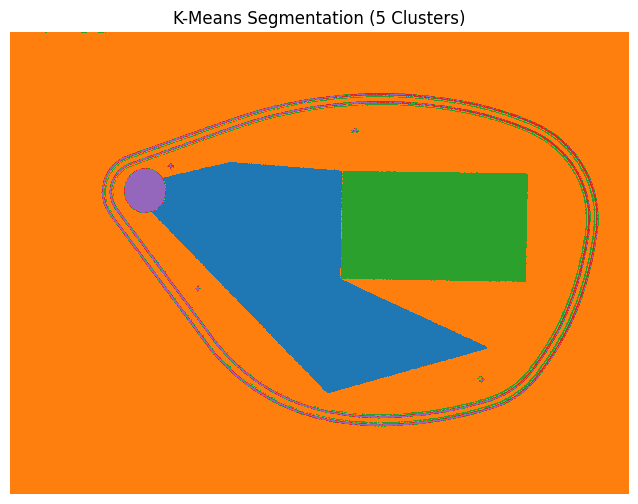

In [28]:

# defects = [
#     "d1",
#     "d2",
#     "d3",
#     "d4",
#     "d5",
#     "d6",
#     "d7",
#     "d8",
#     "d9",
#     "d10",
#     "d11",
#     "d12",
#     "d13",
#     "d14",
# ]

defects= ['d0', 'd3', 'd4', 'd7', 'd10', 'd12', 'd13', 'd18', 'd19', 'd20', 'd21', 'd22']
band = 550


ref_RGB = R_sample[
    [wavelengths.index(650), wavelengths.index(550), wavelengths.index(470)],
    :,
    :,
]
ref_rgb = np.moveaxis(ref_RGB, 0, -1)


ref_mask = compute_IC_mask(ref_rgb)


R_image = R_sample[wavelengths.index(band), :, :]
R_image_norm = R_image / np.max(R_image)
R_image_norm = (R_image_norm * 255).astype(np.uint8)
_, R_image_binary = cv2.threshold(R_image_norm, 60, 255, cv2.THRESH_BINARY_INV)


Aligning d0...


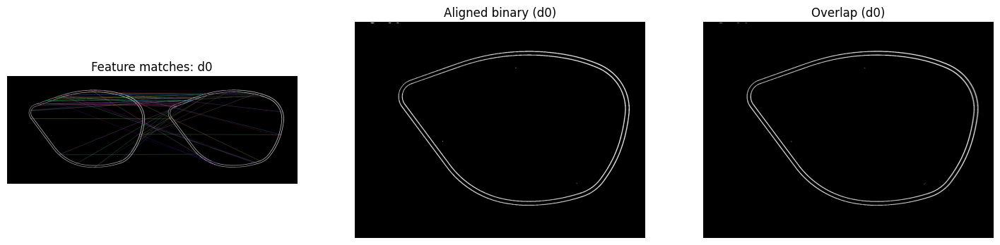

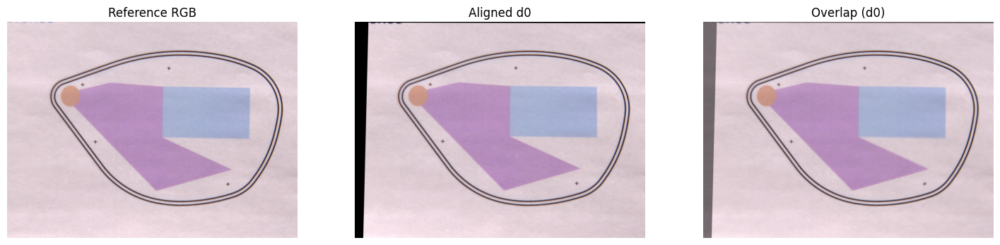

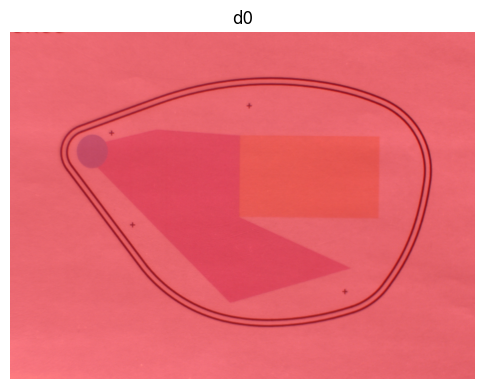

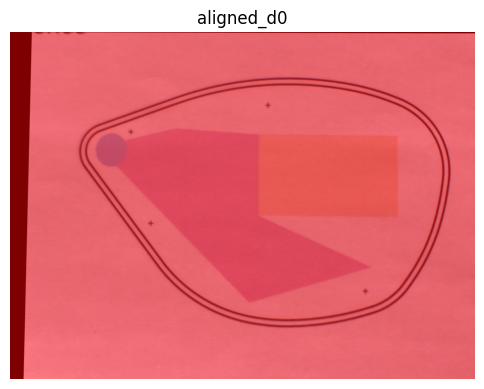


Aligning d3...


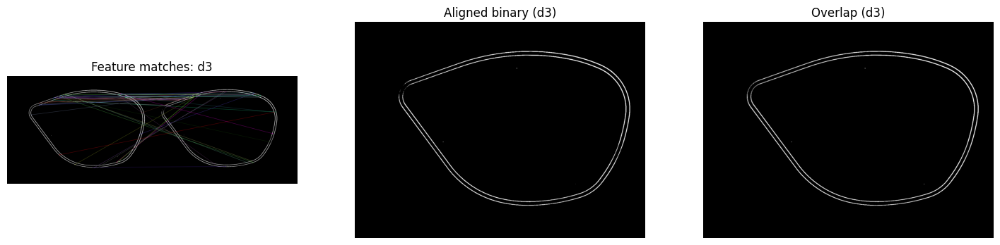

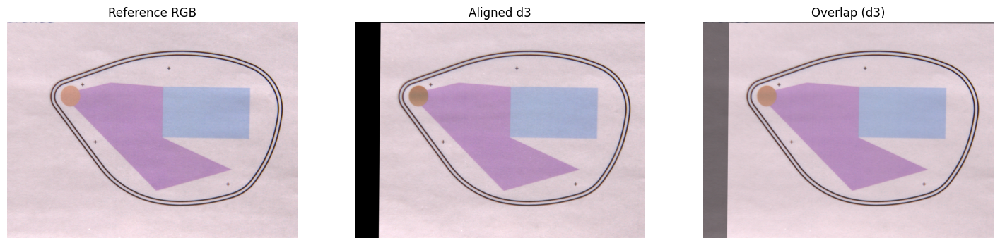

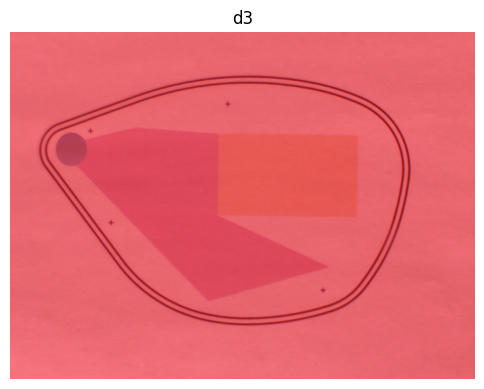

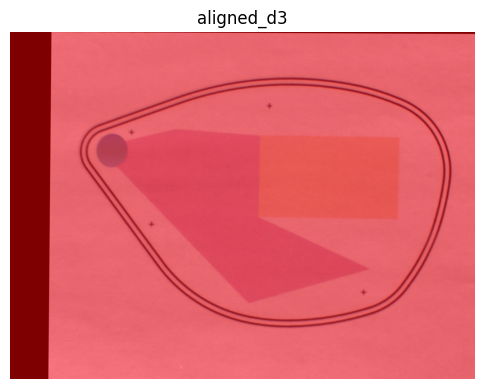


Aligning d4...


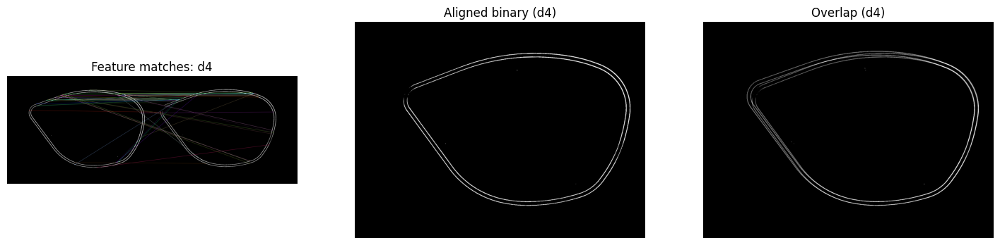

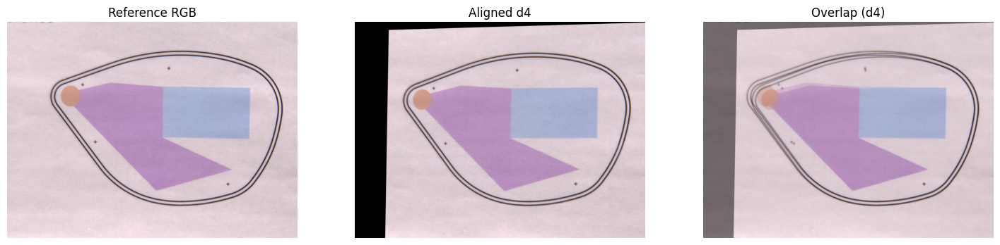

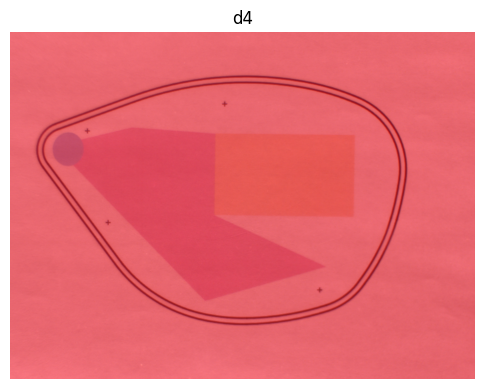

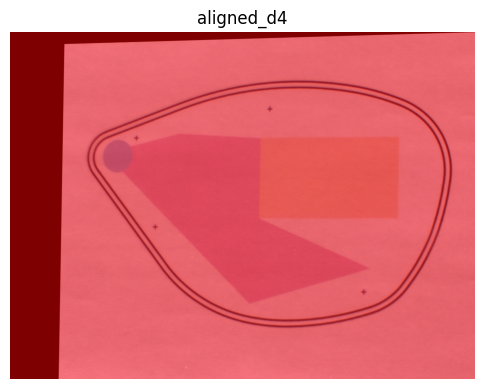


Aligning d7...


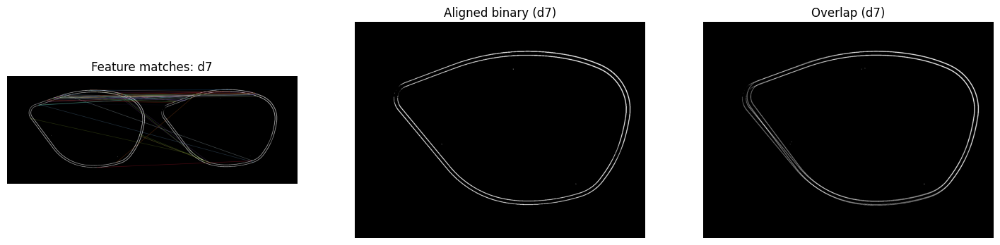

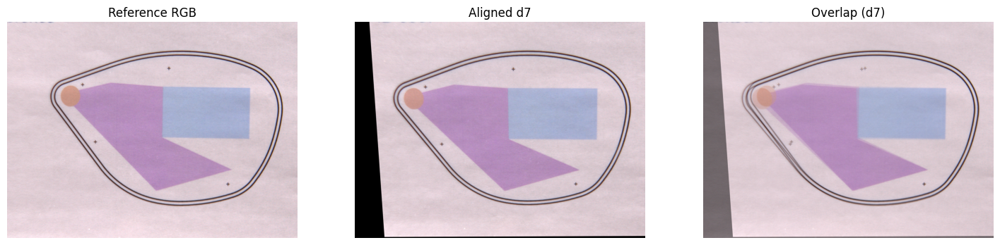

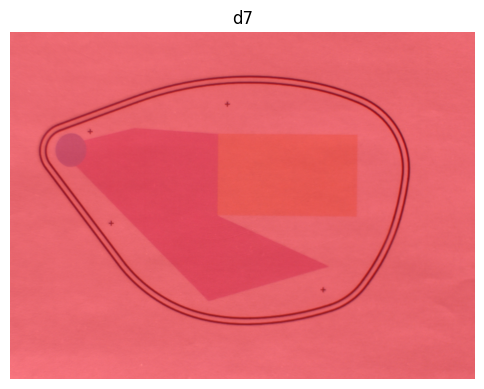

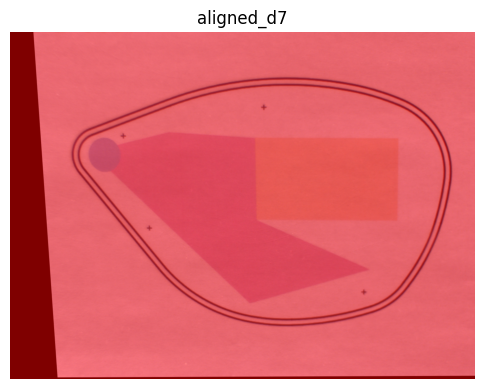


Aligning d10...


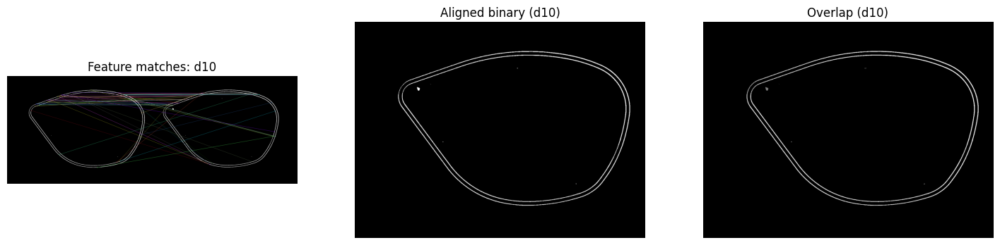

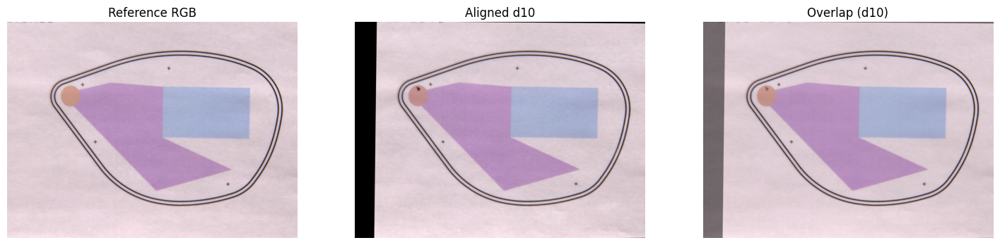

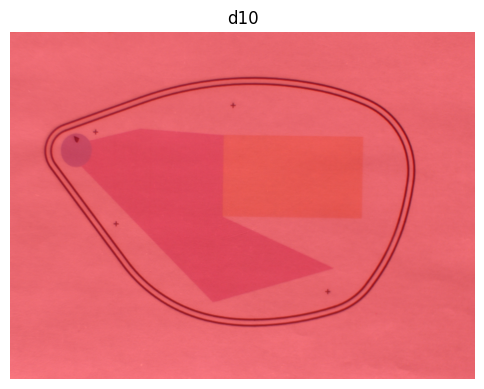

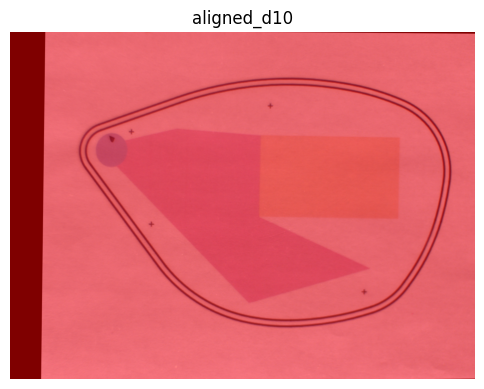


Aligning d12...


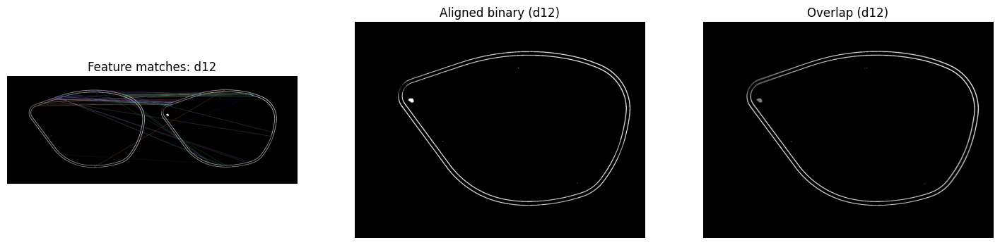

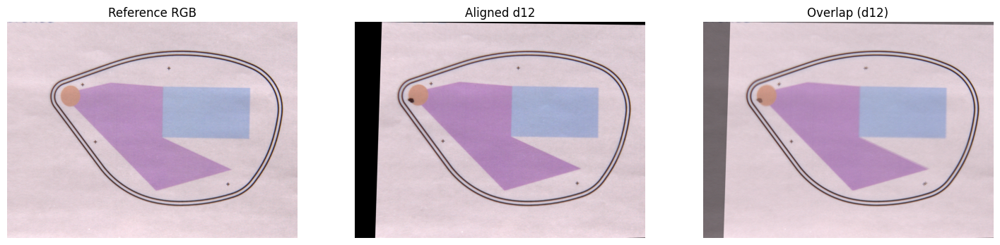

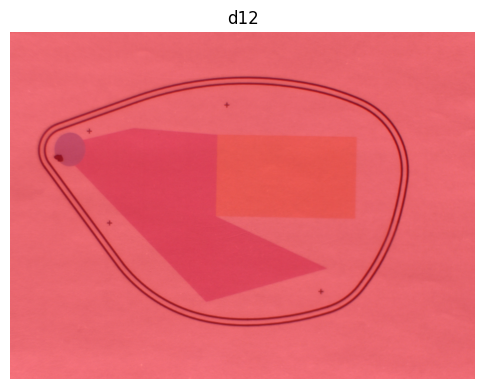

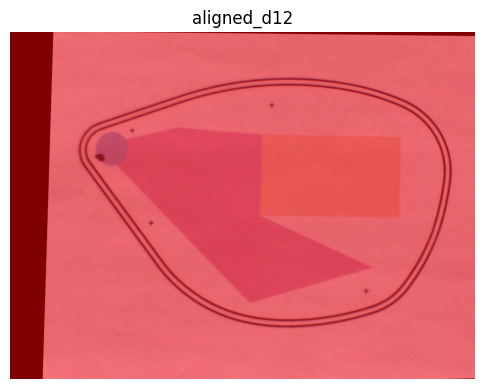


Aligning d13...


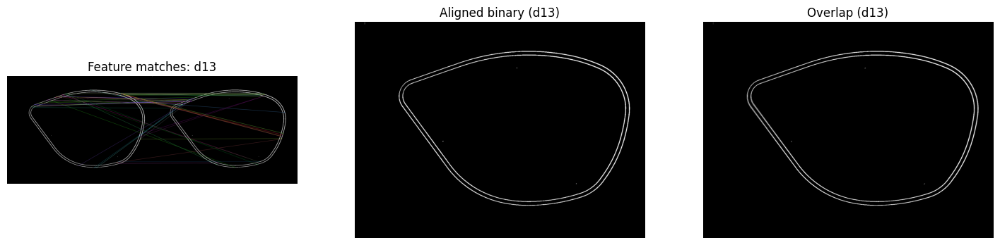

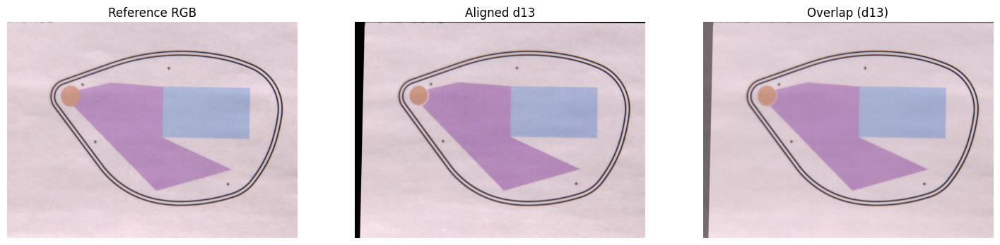

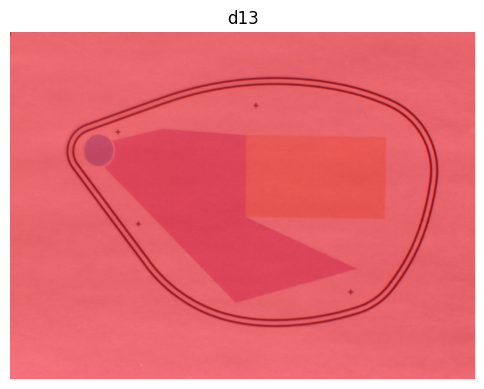

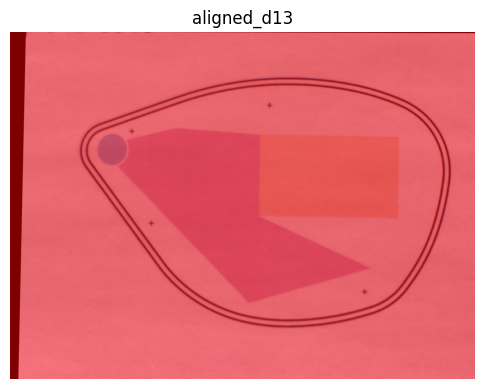


Aligning d18...


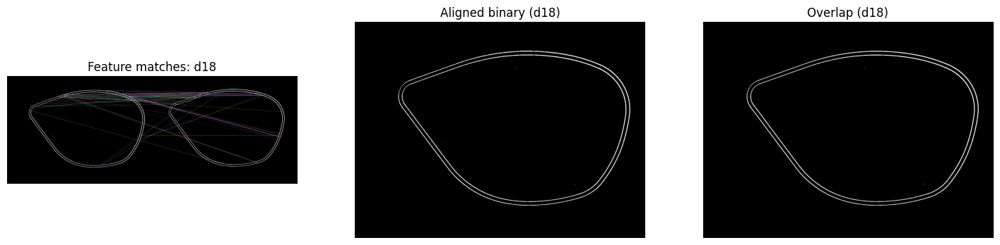

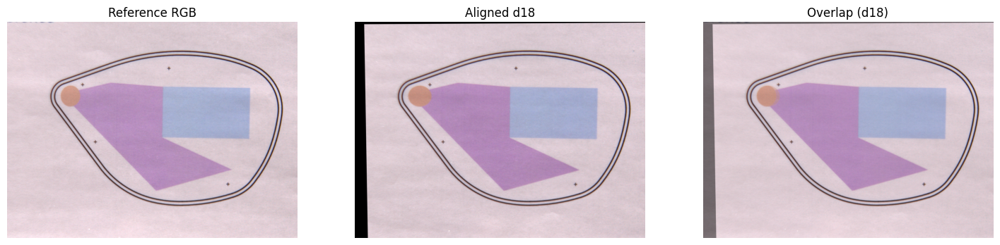

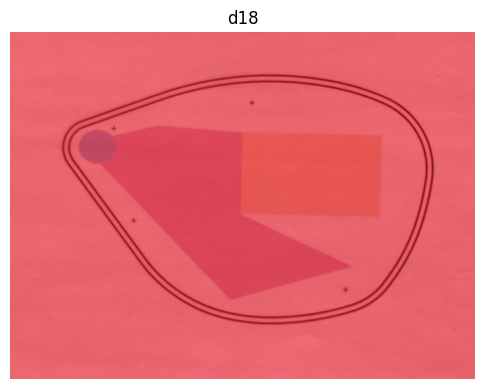

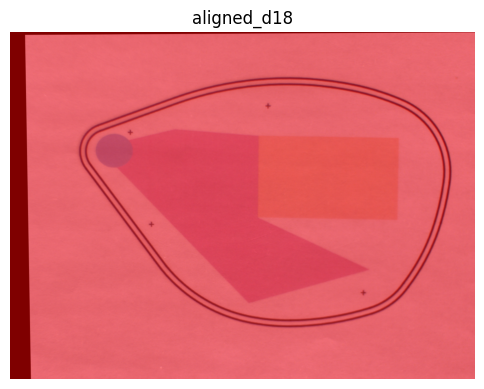


Aligning d19...


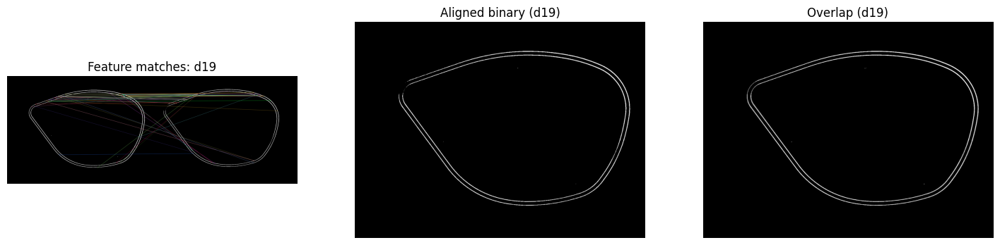

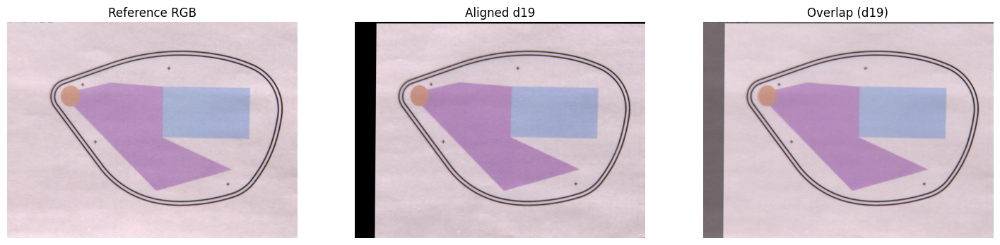

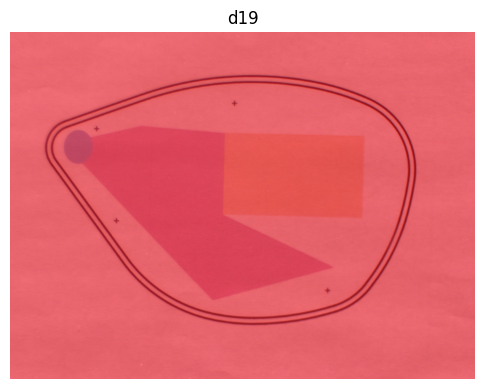

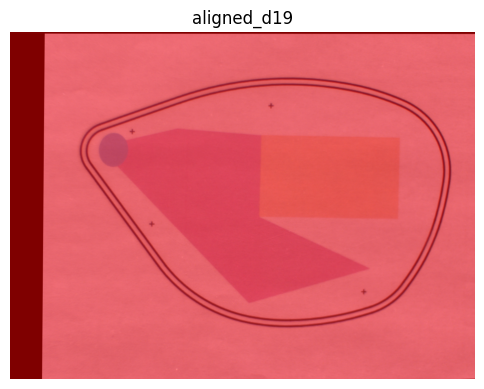


Aligning d20...


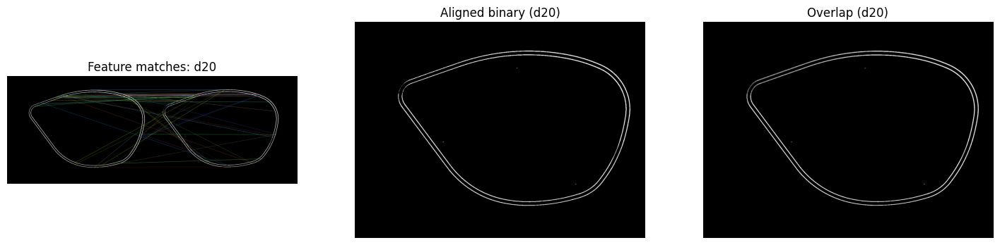

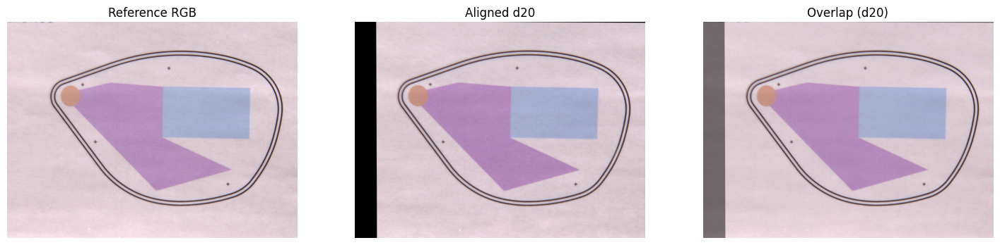

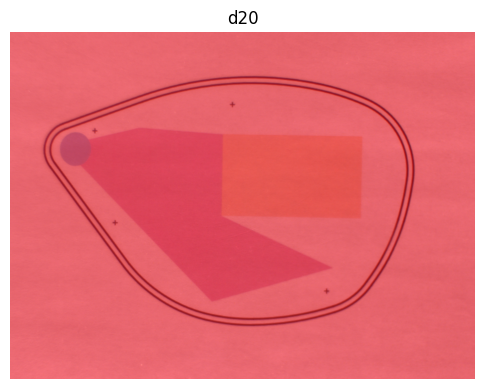

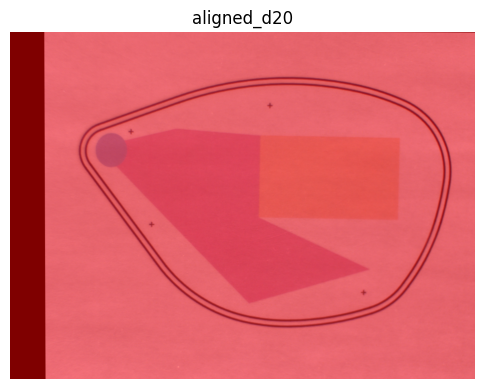


Aligning d21...


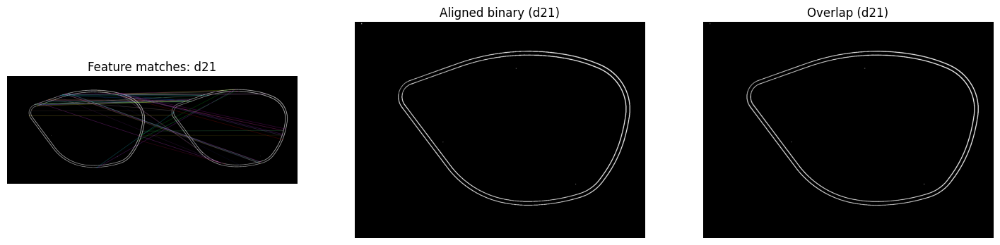

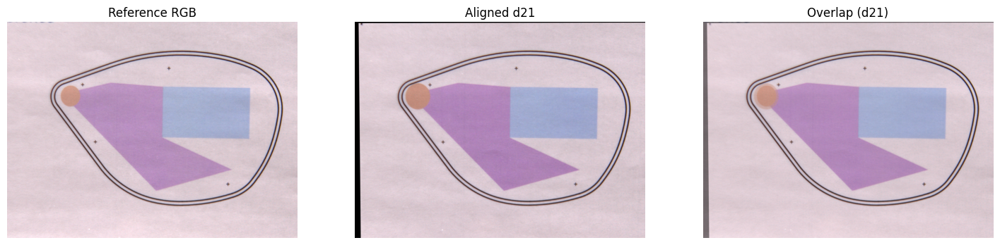

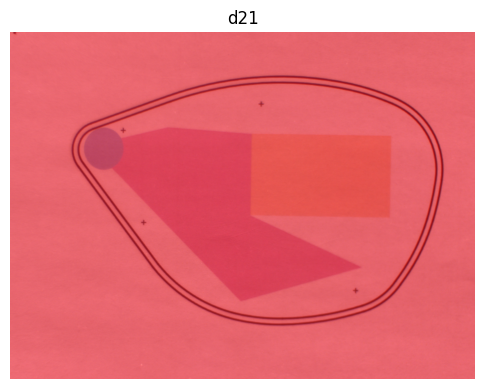

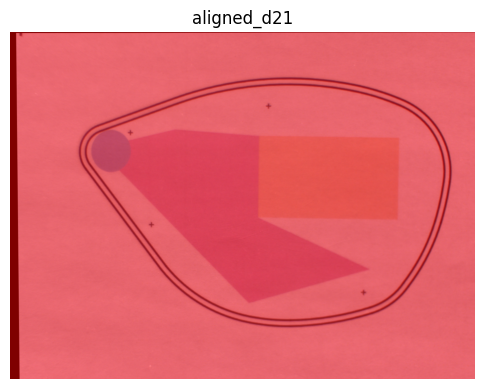


Aligning d22...


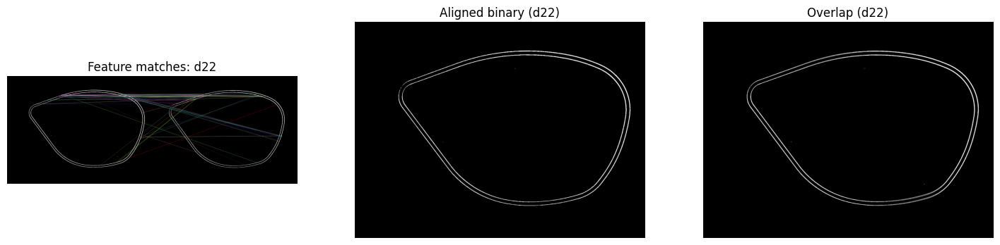

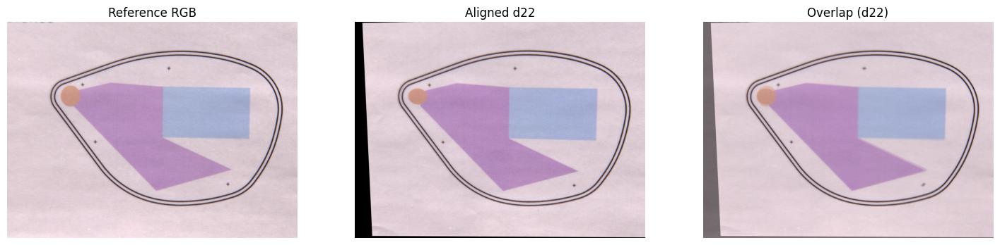

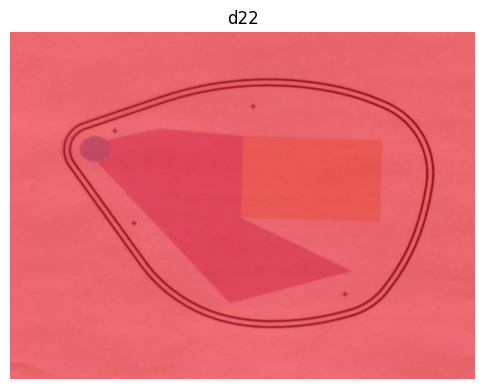

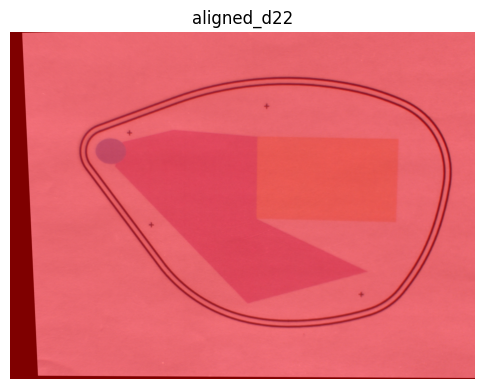

In [ ]:
defect_homographies = []

for defect in defects:
    print(f"\nAligning {defect}...")
    binary_image = convert_binary_image(defect_cubes, defect, band)
    H = align_and_visualise_homography(R_image_binary, binary_image, defect)
    defect_homographies.append(H)

    ref_RGB = extract_RGB(R_sample, wavelengths)
    defect_RGB = extract_RGB(defect_cubes[defect], wavelengths)

    ref_rgb = np.moveaxis(ref_RGB, 0, -1)
    defect_rgb = np.moveaxis(defect_RGB, 0, -1)

    if ref_rgb.dtype != np.uint8:
        ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)
    if defect_rgb.dtype != np.uint8:
        defect_rgb = np.clip(defect_rgb * 255, 0, 255).astype(np.uint8)

    aligned_defect, blended = align_and_blend_RGB_homography(ref_rgb, defect_rgb, H, defect)

    overlay_mask(defect_rgb, ref_mask, defect, color=(1, 0, 0), alpha=0.5)
    overlay_mask(aligned_defect, ref_mask, f"aligned_{defect}", color=(1, 0, 0), alpha=0.5)

In [ ]:

def get_circle_info(mask):

    contours, _ = cv2.findContours(mask, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    if not contours:
        return None

    largest_contour = max(contours, key=cv2.contourArea)

    M = cv2.moments(largest_contour)
    if M["m00"] == 0:
        return None

    centroid_x = M["m10"] / M["m00"]
    centroid_y = M["m01"] / M["m00"]

    area = cv2.contourArea(largest_contour)
    perimeter = cv2.arcLength(largest_contour, True)

    (x, y), radius = cv2.minEnclosingCircle(largest_contour)

    ellipse = cv2.fitEllipse(largest_contour) if len(largest_contour) >= 5 else None

    circularity = 4 * np.pi * area / (perimeter**2) if perimeter > 0 else 0

    return {
        "centroid": (centroid_x, centroid_y),
        "area": area,
        "perimeter": perimeter,
        "min_enclosing_circle": {"center": (x, y), "radius": radius},
        "ellipse": ellipse,
        "circularity": circularity,
        # "contour": largest_contour,
    }


circle_info = get_circle_info(ref_mask)
print(f"circle_info: {circle_info}")

print(f"len(defect_homographies): {len(defect_homographies)}")
print(f"defect_homographies: {defect_homographies}")
print(f"defect_homographies[0]: {defect_homographies[0]}")

circle_info: {'centroid': (695.5, 519.5), 'area': 1445249.0, 'perimeter': 4860.0, 'min_enclosing_circle': {'center': (695.5, 519.5), 'radius': 868.101806640625}, 'ellipse': None, 'circularity': 0.7689179564443082}
len(defect_homographies): 12
defect_homographies: [array([[ 9.88392547e-01, -2.54649167e-02,  6.53427411e+01],
       [ 2.79577825e-03,  9.64721354e-01,  3.40357552e+00],
       [ 3.02386683e-06, -3.66559740e-05,  1.00000000e+00]]), array([[ 1.00650398e+00, -9.48273418e-03,  1.24066859e+02],
       [ 4.98742600e-03,  1.00006438e+00,  2.56355866e+00],
       [ 4.64430201e-06, -3.92497589e-06,  1.00000000e+00]]), array([[ 9.36885582e-01, -1.90514361e-02,  1.62830422e+02],
       [-2.83226979e-02,  9.51248091e-01,  3.88819436e+01],
       [-2.86000976e-05, -1.68863012e-05,  1.00000000e+00]]), array([[ 1.05256471e+00,  7.98196659e-02,  6.98010753e+01],
       [-2.93247620e-03,  1.06864132e+00, -1.33088976e-01],
       [ 1.16103830e-06,  7.06646885e-05,  1.00000000e+00]]), array([


Processing d0...

Processing d3...

Processing d4...

Processing d7...

Processing d10...

Processing d12...

Processing d13...

Processing d18...

Processing d19...

Processing d20...

Processing d21...

Processing d22...


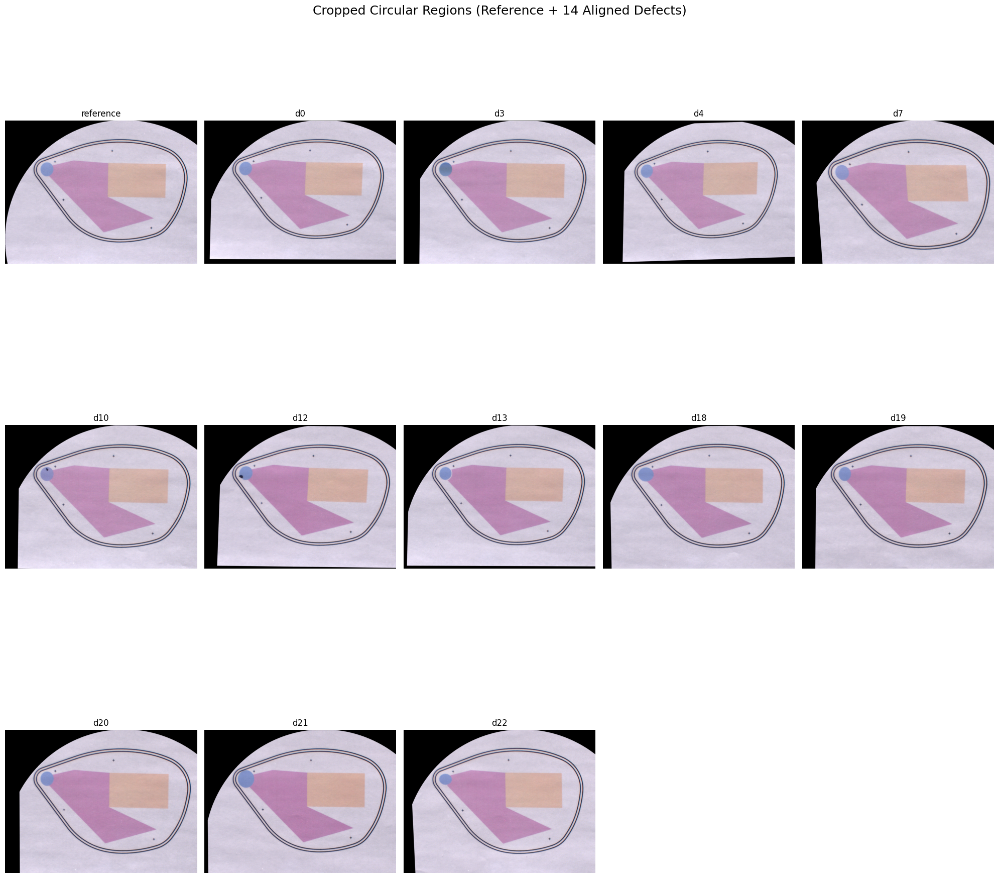

In [ ]:
def crop_circle(image, center, radius):
    x, y = center
    r = int(radius) - 5
    
    x, y = int(round(x)), int(round(y))
    h, w = image.shape[:2]
    y1, y2 = max(0, y - r), min(h, y + r)
    x1, x2 = max(0, x - r), min(w, x + r)
    
    cropped_rect = image[y1:y2, x1:x2]
    
    mask = np.zeros(cropped_rect.shape[:2], dtype=np.uint8)
    cv2.circle(mask, (r, r), r, 255, -1)

    if len(cropped_rect.shape) == 3:
        masked = cv2.bitwise_and(cropped_rect, cropped_rect, mask=mask)
    else:
        masked = cv2.bitwise_and(cropped_rect, cropped_rect, mask=mask)
    
    return masked


ref_RGB = extract_RGB(R_sample, wavelengths)
ref_rgb = np.moveaxis(ref_RGB, 0, -1)
if ref_rgb.dtype != np.uint8:
    ref_rgb = np.clip(ref_rgb * 255, 0, 255).astype(np.uint8)

circle_center = circle_info["min_enclosing_circle"]["center"]
circle_radius = circle_info["min_enclosing_circle"]["radius"]

ref_cropped = crop_circle(ref_rgb, circle_center, circle_radius)

cropped_circles = [ref_cropped]
titles = ["reference"] + defects

plt.figure(figsize=(20, 20))
cols = 5
rows = math.ceil((len(defects) + 1) / cols)

for i, defect_name in enumerate(defects):
    print(f"\nProcessing {defect_name}...")
    A_3x3 = defect_homographies[i]

    defect_RGB = extract_RGB(defect_cubes[defect_name], wavelengths)
    defect_rgb = np.moveaxis(defect_RGB, 0, -1)
    if defect_rgb.dtype != np.uint8:
        defect_rgb = np.clip(defect_rgb * 255, 0, 255).astype(np.uint8)

    A_2x3 = A_3x3[:2, :]
    h, w = ref_rgb.shape[:2]
    aligned_defect = cv2.warpAffine(defect_rgb, A_2x3, (w, h))

    cropped_circle = crop_circle(aligned_defect, circle_center, circle_radius)
    cropped_circles.append(cropped_circle)

for idx, (img, title) in enumerate(zip(cropped_circles, titles)):
    plt.subplot(rows, cols, idx + 1)
    if img.ndim == 2:
        plt.imshow(img, cmap="gray")
    else:
        plt.imshow(img)
    plt.title(title)
    plt.axis("off")

plt.suptitle("Cropped Circular Regions (Reference + 14 Aligned Defects)", fontsize=18)
plt.tight_layout()
plt.show()


Computing spectral average for d0...
Computing spectral average for d3...
Computing spectral average for d4...
Computing spectral average for d7...
Computing spectral average for d10...
Computing spectral average for d12...
Computing spectral average for d13...
Computing spectral average for d18...
Computing spectral average for d19...
Computing spectral average for d20...
Computing spectral average for d21...
Computing spectral average for d22...


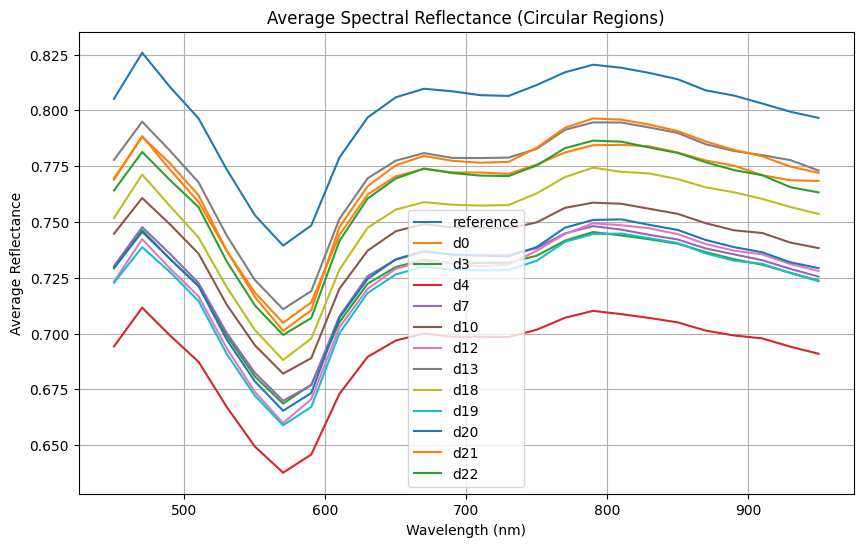

In [ ]:
def average_reflectance_in_circle(hypercube, center, radius, transform=None):

    bands, h, w = hypercube.shape
    
    if transform is not None:
        if transform.shape == (3, 3):
            hypercube_aligned = np.stack([
                cv2.warpPerspective(hypercube[i], transform, (w, h))
                for i in range(bands)
            ])
        else:
            raise ValueError("Transform must be 3x3 matrix")
    else:
        hypercube_aligned = hypercube
    
    mask = np.zeros((h, w), dtype=np.uint8)
    cx, cy = int(round(center[0])), int(round(center[1]))
    r = int(radius) - 5
    cv2.circle(mask, (cx, cy), r, 1, -1)

    mean_reflectance = []
    for i in range(bands):
        band = hypercube_aligned[i]
        masked_pixels = band[mask == 1]
        if masked_pixels.size > 0:
            mean_reflectance.append(np.mean(masked_pixels))
        else:
            mean_reflectance.append(np.nan)
    
    return np.array(mean_reflectance)

ref_spectrum = average_reflectance_in_circle(R_sample, circle_center, circle_radius)

spectra = {"reference": ref_spectrum}

for i, defect_name in enumerate(defects):
    print(f"Computing spectral average for {defect_name}...")
    cube = defect_cubes[defect_name]
    A_3x3 = defect_homographies[i]
    spec = average_reflectance_in_circle(cube, circle_center, circle_radius, transform=A_3x3)
    spectra[defect_name] = spec

plt.figure(figsize=(10, 6))
for name, spectrum in spectra.items():
    plt.plot(wavelengths, spectrum, label=name)

plt.xlabel("Wavelength (nm)")
plt.ylabel("Average Reflectance")
plt.title("Average Spectral Reflectance (Circular Regions)")
plt.legend()
plt.grid(True)
plt.show()


Interpolating and converting reference to LAB...
Processing d0...
Processing d3...
Processing d4...
Processing d7...
Processing d10...
Processing d12...
Processing d13...
Processing d18...
Processing d19...
Processing d20...
Processing d21...
Processing d22...

Average ΔE (CIE76) values per defect:
   defect    ΔE_mean
0      d0   9.462513
1      d3  10.380565
2      d4  17.675883
3      d7  10.938107
4     d10   9.236187
5     d12  12.028902
6     d13   6.953773
7     d18   6.609253
8     d19  10.086016
9     d20   9.862673
10    d21   4.503234
11    d22   6.979153


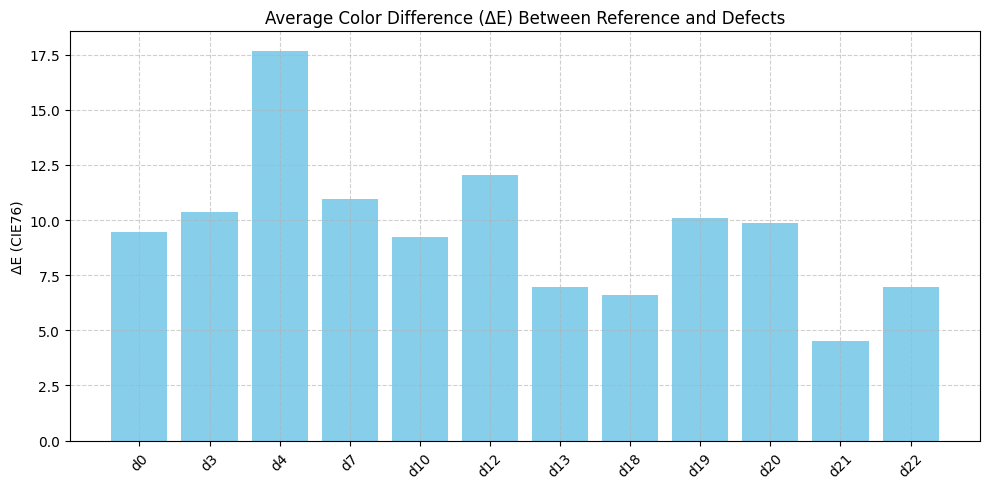

✅ Results saved to deltaE_results.csv


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import cv2
import pandas as pd
from CSL_2025_Python_codes import spim2XYZ, XYZ2Lab

def calculate_delta_E(LAB_ref, LAB_def, mask=None):
    delta = LAB_ref - LAB_def
    deltaE = np.sqrt(np.sum(delta**2, axis=2))
    if mask is not None:
        deltaE = deltaE[mask > 0]
    return np.nanmean(deltaE)

from scipy.interpolate import interp1d

def interpolate_spectral_cube(spectral_cube, input_wavelengths, wl_min=300, wl_max=950, wl_step=1):
    """ Interpolate hyperspectral cube to a new wavelength range """
    input_wavelengths = np.array(input_wavelengths)
    bands, H, W = spectral_cube.shape

    output_wavelengths = np.arange(wl_min, wl_max + wl_step, wl_step)
    cube_reshaped = spectral_cube.reshape(bands, -1)

    interp_func = interp1d(
        input_wavelengths, cube_reshaped, kind='linear', axis=0,
        bounds_error=False, fill_value='extrapolate'
    )

    cube_interp = interp_func(output_wavelengths)
    spectral_cube_interp = cube_interp.reshape(len(output_wavelengths), H, W)

    return spectral_cube_interp, output_wavelengths

print("Interpolating and converting reference to LAB...")
R_sample_interp, new_wavelengths = interpolate_spectral_cube(R_sample, wavelengths, wl_min=360, wl_max=830, wl_step=10)
R_sample_interp = np.transpose(R_sample_interp, (1, 2, 0))  # (H, W, bands)

XYZ_ref = spim2XYZ(R_sample_interp, new_wavelengths, "D65")
LAB_ref = XYZ2Lab(XYZ_ref, new_wavelengths, "D65")

mask_ref = np.zeros(LAB_ref.shape[:2], dtype=np.uint8)
cx, cy = int(circle_center[0]), int(circle_center[1])
r = int(circle_radius) - 5
cv2.circle(mask_ref, (cx, cy), r, 1, -1)

deltaE_results = []

for i, defect_name in enumerate(defects):
    print(f"Processing {defect_name}...")

    cube = defect_cubes[defect_name]
    A_3x3 = defect_homographies[i]
    bands, h, w = cube.shape

    cube_aligned = np.stack([
        cv2.warpAffine(cube[j], A_3x3[:2, :], (w, h))
        for j in range(bands)
    ])

    cube_interp, _ = interpolate_spectral_cube(cube_aligned, wavelengths, wl_min=360, wl_max=830, wl_step=10)
    cube_interp = np.transpose(cube_interp, (1, 2, 0))  # (H, W, bands)

    XYZ_def = spim2XYZ(cube_interp, new_wavelengths, "D65")
    LAB_def = XYZ2Lab(XYZ_def, new_wavelengths, "D65")

    ΔE_mean = calculate_delta_E(LAB_ref, LAB_def, mask=mask_ref)
    deltaE_results.append({"defect": defect_name, "ΔE_mean": ΔE_mean})

deltaE_df = pd.DataFrame(deltaE_results)
print("\nAverage ΔE (CIE76) values per defect:")
print(deltaE_df)

plt.figure(figsize=(10, 5))
plt.bar(deltaE_df["defect"], deltaE_df["ΔE_mean"], color="skyblue")
plt.ylabel("ΔE (CIE76)")
plt.title("Average Color Difference (ΔE) Between Reference and Defects")
plt.xticks(rotation=45)
plt.grid(True, linestyle="--", alpha=0.6)
plt.tight_layout()
plt.show()

deltaE_df.to_csv("deltaE_results.csv", index=False)
print("✅ Results saved to deltaE_results.csv")
